# WUM 2020: homework #7 *\[PCA image compression\]*
# Jakub Kosterna

<h1 id="tocheading">Table of Contents</h1>
<div id="toc"></div>

# Oh yeah, so much fun awaits me!

Lossy compression in graphics! Woohoo, I love this topic!! Could it be more beautiful? It probably could, but it still excites me pretty well.

But... only one image? No way, it would be too boring! In this homework I decided to bet on... **22** pictures! Why exactly 22? Well, as a big longtime fan of cartoon series ***Total drama*** and an uncle to three lovely kids aged between 8 and 10, in last weeks I have been coding a window application in Java that simulates the lives of these characters and is also a game for a few. To create it, I also prepared the icons of 22 original contestants of the first season - 300x300 jpg icons I placed in the *images* folder.

# Loading the images

In [1]:
from os import listdir
from os.path import isfile, join

In [2]:
images_path = './images'
file_paths = []
contestant_names = []
n_contestants = len(listdir(images_path))
for im in listdir(images_path):
    file_paths.append(images_path + '/' + im)
    contestant_names.append(im[0:-4].capitalize())

In [3]:
import pandas as pd
pd.DataFrame({'File paths': file_paths, 'Contestant names': contestant_names})

,File paths,Contestant names
0,./images/beth.jpg,Beth
1,./images/bridgette.jpg,Bridgette
2,./images/cody.jpg,Cody
3,./images/courtney.jpg,Courtney
4,./images/dj.jpg,Dj
5,./images/duncan.jpg,Duncan
6,./images/eva.jpg,Eva
7,./images/ezekiel.jpg,Ezekiel
8,./images/geoff.jpg,Geoff
9,./images/gwen.jpg,Gwen


# Visualization

Great! We already have lists of their file paths and names. Let's visualize them to make sure everything was successful!

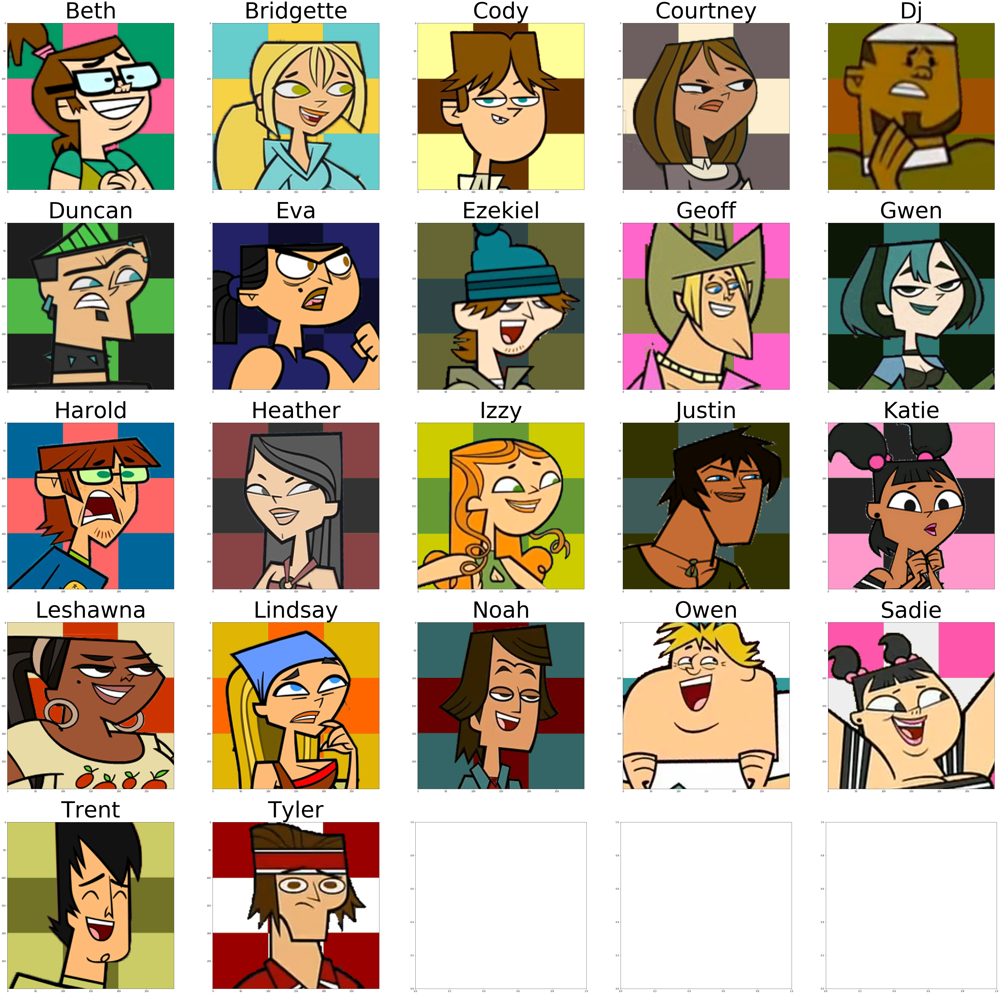

In [4]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

fig, axs = plt.subplots(5, 5, figsize = (80, 80))
images = [0] * n_contestants
for i in range(len(file_paths)):
    img = mpimg.imread(file_paths[i])
    imgplot = axs[i//5, i%5].imshow(img)
    axs[i//5, i%5].set_title(contestant_names[i], fontsize = 100)
    images[i] = img

Loading all my favorite smileys from *Total Drama Island* went according to plan!

# Reshaping

It shouldn't be difficult. Out of curiosity, using the RGB property, I will also see average brightness of graphics. And having them, why not show the brightest and the darkest picture?

I will create two new lists - one in 1d with just 270 000 numbers (to facilitate the coding of the extra operations mentioned above) and one in 2d - 300x3 for width & colors and 300 for height.

In [5]:
import numpy as np

brightest_image = images[0]
darkest_image = images[0]
minimum_rgb_avg = 255
maximum_rgb_avg = 0
brightest_con_name = contestant_names[0]
darkest_con_name = contestant_names[0]

images_reshaped = [0] * n_contestants
for i in range(len(images)):
    im = images[i]
    # reshaping
    reshaped1d = np.reshape(np.array(im), 300 * 300 * 3) # 300 - width, 300 - height, 3 - RGB format
    reshaped2d = np.reshape(np.array(im), (300 * 3, 300))
    images_reshaped[i] = reshaped2d
    
    # brightness info
    avg_rgb = np.mean(reshaped1d)
    print("Average pixel brightness of " + contestant_names[i] + ": " + str(avg_rgb))
    
    # searching for the brightest and the darkest
    if avg_rgb > maximum_rgb_avg:
        maximum_rgb_avg = avg_rgb
        brightest_image = im
        brightest_con_name = contestant_names[i]
    elif avg_rgb < minimum_rgb_avg:
        minimum_rgb_avg = avg_rgb
        darkest_image = im
        darkest_con_name = contestant_names[i]

Average pixel brightness of Beth: 113.45054444444445
Average pixel brightness of Bridgette: 158.15185555555556
Average pixel brightness of Cody: 145.10085925925927
Average pixel brightness of Courtney: 114.06719259259259
Average pixel brightness of Dj: 79.52761851851852
Average pixel brightness of Duncan: 86.31382962962962
Average pixel brightness of Eva: 89.6173037037037
Average pixel brightness of Ezekiel: 90.96717407407408
Average pixel brightness of Geoff: 141.72973333333334
Average pixel brightness of Gwen: 73.8476
Average pixel brightness of Harold: 101.96164074074073
Average pixel brightness of Heather: 99.33561481481482
Average pixel brightness of Izzy: 129.6100962962963
Average pixel brightness of Justin: 59.29105925925926
Average pixel brightness of Katie: 110.71815925925925
Average pixel brightness of Leshawna: 111.9070962962963
Average pixel brightness of Lindsay: 125.68234814814815
Average pixel brightness of Noah: 72.99735925925926
Average pixel brightness of Owen: 186.67

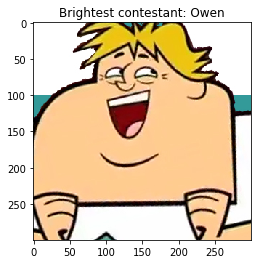

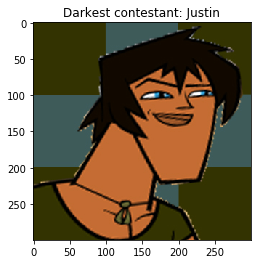

In [6]:
plt.imshow(brightest_image)
plt.title("Brightest contestant: " + brightest_con_name)
plt.show()

plt.imshow(darkest_image)
plt.title("Darkest contestant: " + darkest_con_name)
plt.show()

I think everything went according to plan!
The black-haired Justin turned out to be the darkest, and the lightest - a thick, light-skinned Owen with a white T-shirt. Makes sense!

What about creating a 2D arrays?

In [7]:
print(images_reshaped[2].shape)
print(images_reshaped[n_contestants-1])
print(reshaped1d)

(900, 300)
[[154   0   0 ... 152   0   2]
 [177 194 160 ... 131  57  28]
 [154   0   0 ... 154   0   0]
 ...
 [154   0   0 ... 162  19   5]
 [162  19   5 ... 146  18  15]
 [131  22  15 ... 154   0   0]]
[154   0   0 ... 154   0   0]


Looks correct also.

# Size of my images

So now we have 22 images, every of them in 300 x 300 x 3 number list. I guess for such small numbers they are presented as 4 byte ints? That would gave 300 x 300 x 3 x 4 bytes = 1 080 000 bytes = ~1 megabyte. But who knows, maybe Python is smarter than I expected and seeing numbers in the range <0; 255> converted each to one byte? Then we would have 300 x 300 x 3 bytes = 270 000 bytes = ~264 kilobytes! Let's check it out.

In [8]:
import sys
for i in range(n_contestants):
    print(contestant_names[i] + "' size: " + str(images_reshaped[i].nbytes))

Beth' size: 270000
Bridgette' size: 270000
Cody' size: 270000
Courtney' size: 270000
Dj' size: 270000
Duncan' size: 270000
Eva' size: 270000
Ezekiel' size: 270000
Geoff' size: 270000
Gwen' size: 270000
Harold' size: 270000
Heather' size: 270000
Izzy' size: 270000
Justin' size: 270000
Katie' size: 270000
Leshawna' size: 270000
Lindsay' size: 270000
Noah' size: 270000
Owen' size: 270000
Sadie' size: 270000
Trent' size: 270000
Tyler' size: 270000


Woah! I'm really positively surprised. In C++ we couldn't do such a thing, at least easily and automatically. Python rules!!

So now we have ~264 kilobytes for every image.

# PCA compression

In the next part I intend to call the PCA algorithm for all images on six numbers of components: 1, 2, 4 and 16. I will write the resulting matrices to the tables and check the sizes - will I really be able to reduce the memory?

In [9]:
from sklearn.decomposition import PCA
import copy

analyzed_n_comp = [1, 2, 4, 16]
anc_len = len(analyzed_n_comp)

pcas = [0] * n_contestants
for i in range(n_contestants):
    pcas[i] = [0] * anc_len
    
sizes = copy.deepcopy(pcas)
pcas_transformed = copy.deepcopy(pcas)

for i in range(n_contestants):
    for j in range(anc_len):
        pca = PCA(analyzed_n_comp[j])
        pcas[i][j] = pca
        pcas_transformed[i][j] = pca.fit_transform(images_reshaped[i])
        sizes[i][j] = pcas_transformed[i][j].nbytes
        
print(sizes)

[[7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200], [7200, 14400, 28800, 115200]]


Comparing the resulting arrays for the original 270 000 bytes, in each case factually I got a smaller amount! Importantly - the number of bytes after calling PCA is constant- the same for each image.

We can see a simple dependency - for every 1 component we have 7200 bytes. Given that each image has 300 x 300 = 270,000 pixels, the situation is really satisfying. That means, setting PCA for less than 38 components, we always get less compression in terms of disk space!

Unfortunately, **each of these compressions will be lossy** - it will not be a perfect reproduction of images from the original. Initially, we got raster graphics, pixel by pixel - here from vectors... we also generate raster graphics paradoxically, but we do not get 1: 1 what was at the beginning.

Let's display the results for *Beth* - at least four elements for each number of components.

In [10]:
for j in range(anc_len):
    print(analyzed_n_comp[j], "components:")
    print(pcas_transformed[0][j][0:4])

1 components:
[[ -580.54029706]
 [ 1450.77885512]
 [-1060.77194963]
 [ -574.53229249]]
2 components:
[[ -580.54029707  -300.39135931]
 [ 1450.77885513  -153.10737903]
 [-1060.77194963   234.56859785]
 [ -574.5322925   -304.79642242]]
4 components:
[[ -580.54029706  -300.39135855   -35.94480535  -587.8125466 ]
 [ 1450.77885513  -153.10737889   148.47755549   -94.26139787]
 [-1060.77194963   234.56859784     2.64109747   370.45342737]
 [ -574.5322925   -304.79642179   -40.28886409  -599.23072865]]
16 components:
[[ -580.54029706  -300.39135853   -35.94480854  -587.81255073
   -609.3356169   -312.21288558   123.437386      91.18894208
     66.10383637     8.66131171   113.25821209   -53.75268122
    181.23113604   -10.95064504     4.07590227   -43.98696354]
 [ 1450.77885513  -153.10737895   148.47755825   -94.26139978
     40.92096769    51.46025547    99.32607152     6.55671358
   -121.54932531  -175.6140863     41.7397361     51.3596392
     69.11221275   131.76700311   -40.34208522   -

# Reconstruction

Ok, time for icing on the cake. Let's see how PCA will manage for our participants - for component numbers 1, 2, 4 and 16!

n of components: 1


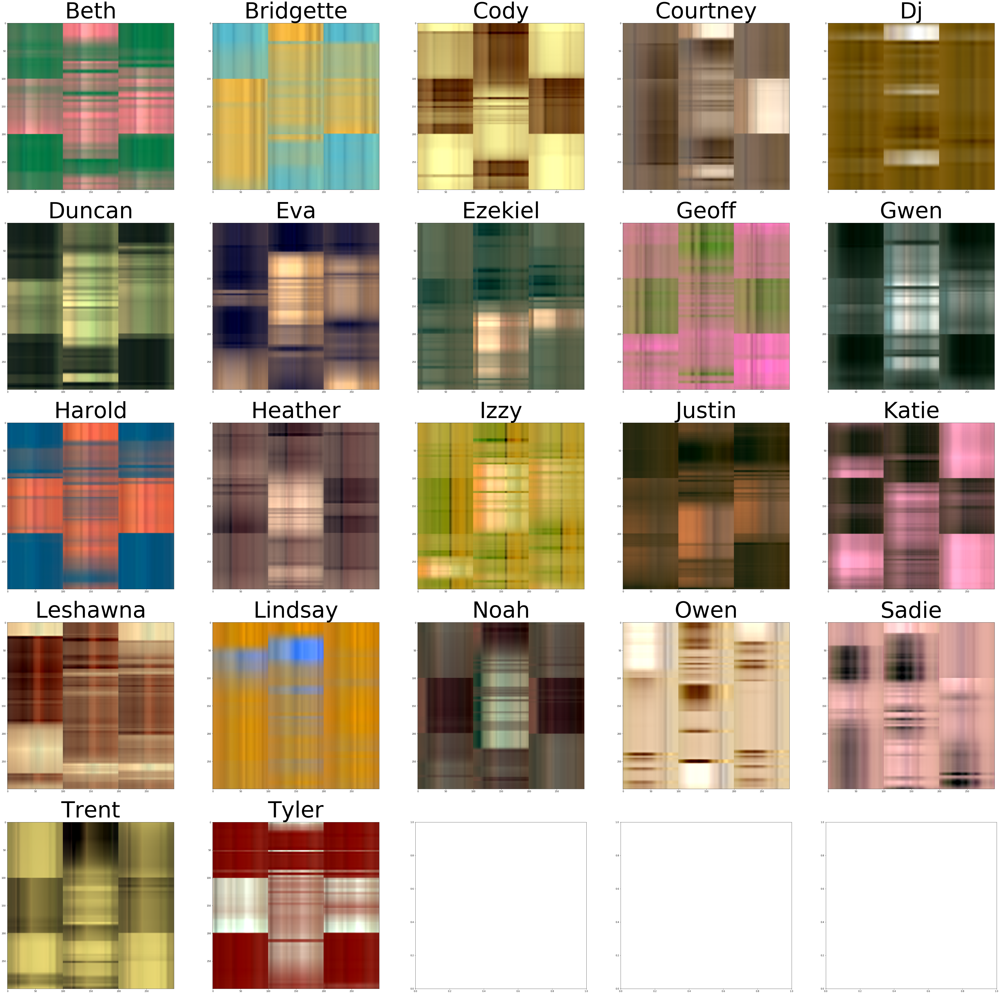

n of components: 2


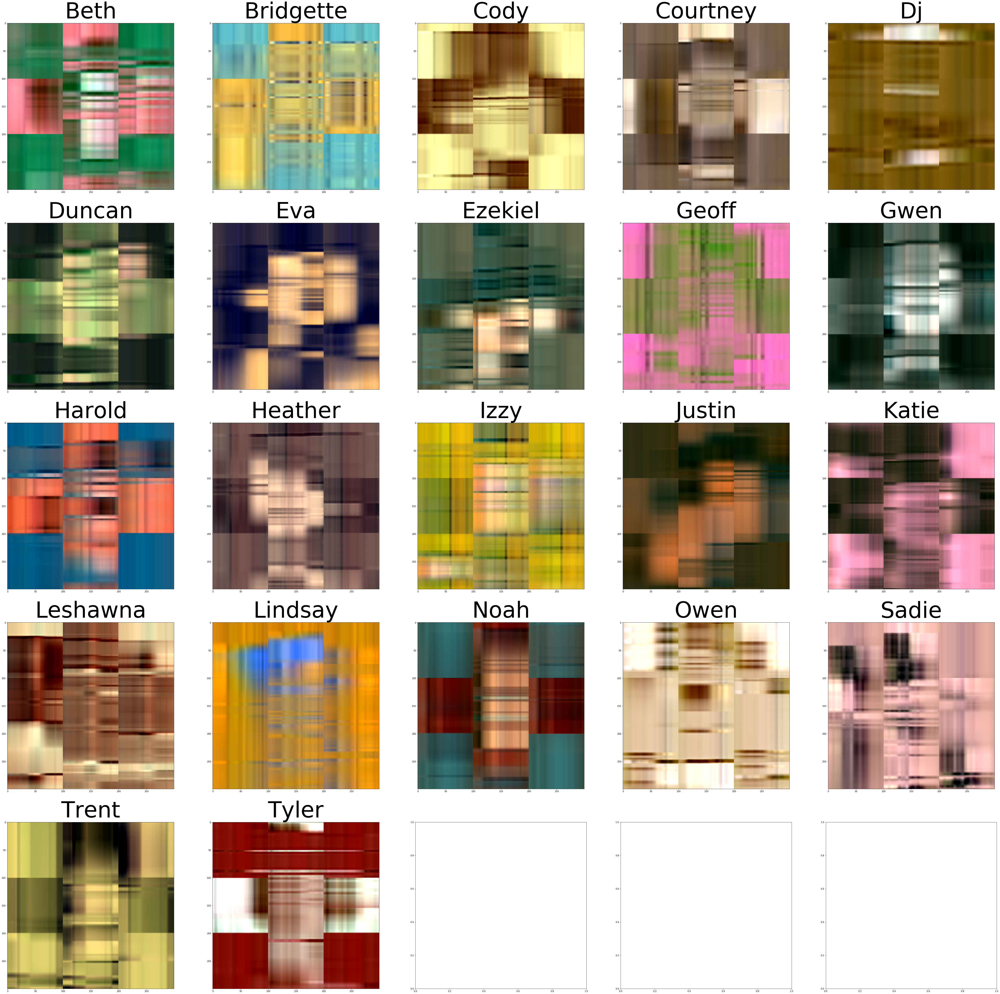

n of components: 4


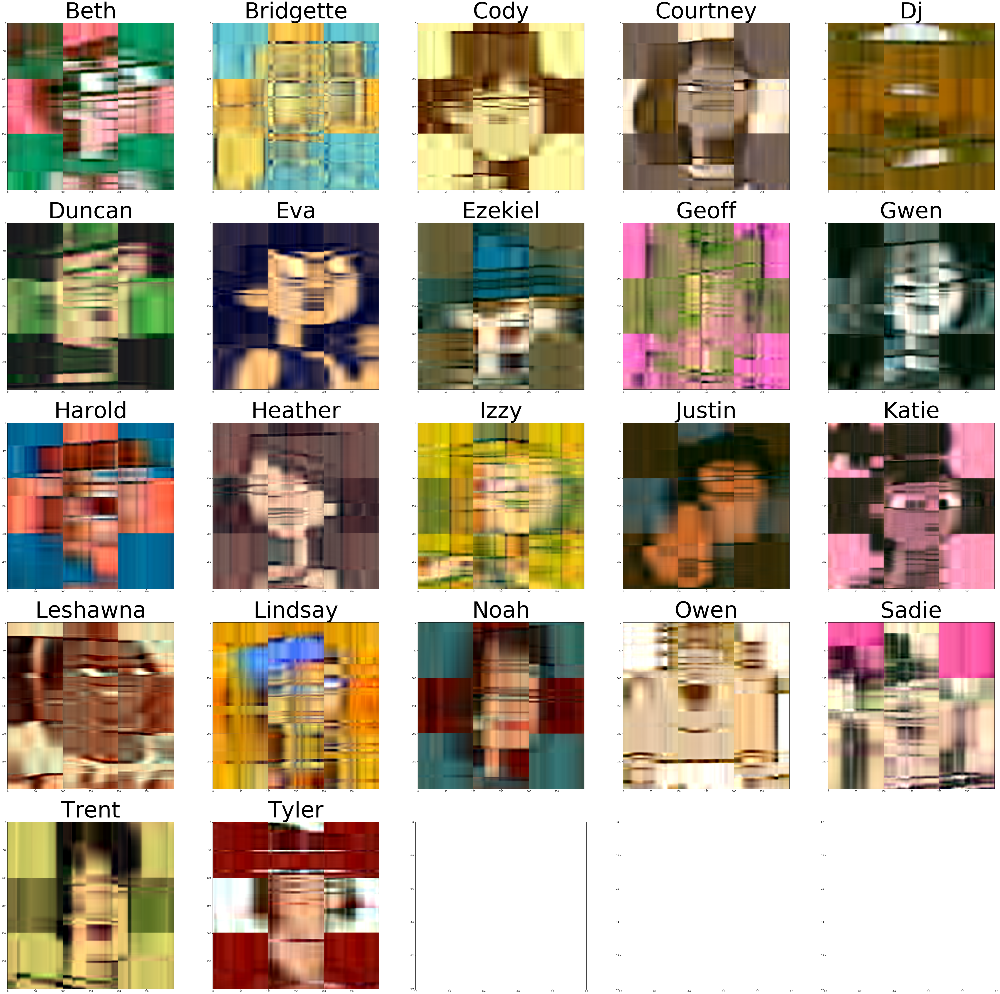

n of components: 16


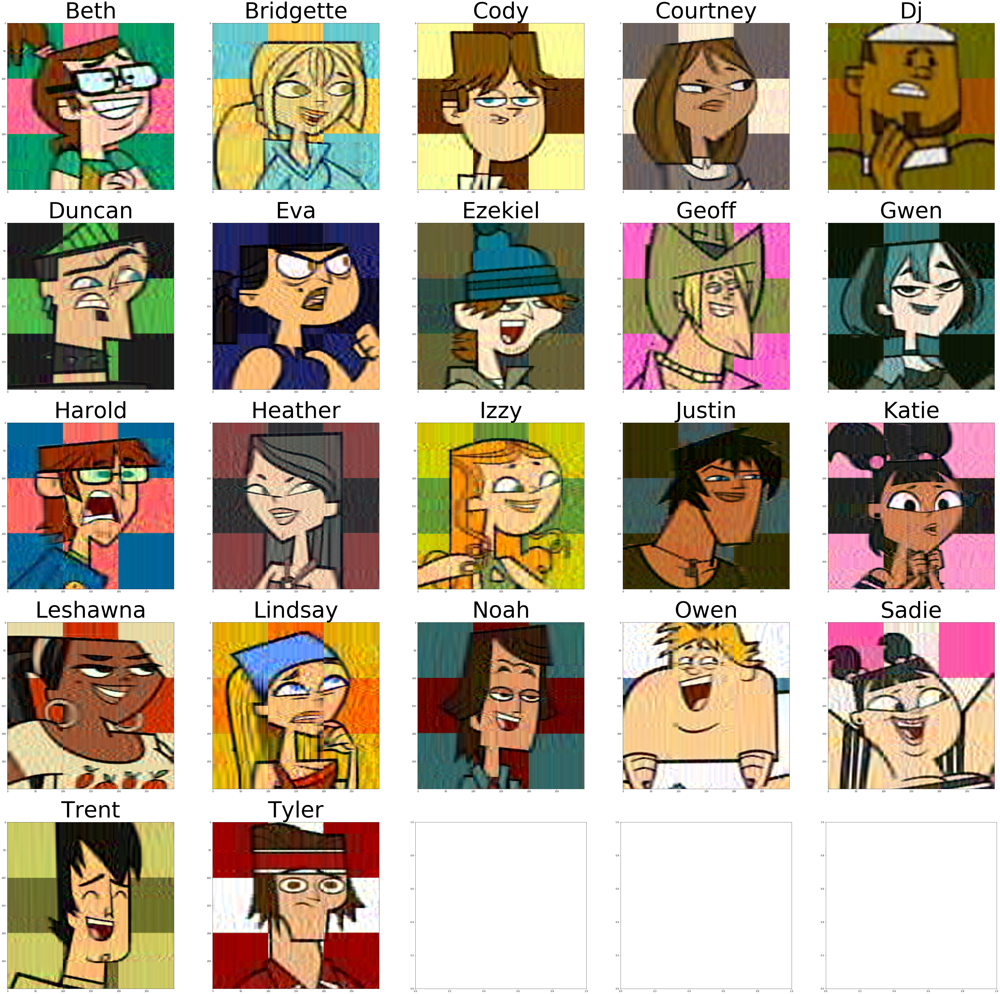

In [11]:
for i in range(anc_len):
    print("n of components:", analyzed_n_comp[i])
    fig, axs = plt.subplots(5, 5, figsize=(80, 80))
    for j in range(n_contestants):
        approximation = pcas[j][i].inverse_transform(pcas_transformed[j][i])
        app = approximation.reshape((300, 300, 3))
        app /= 256
        for x in range(300):
            for y in range(300):
                for col in range(3):
                    if app[x][y][col] < 0:
                        app[x][y][col] = 0
                    elif app[x][y][col] > 1:
                        app[x][y][col] = 1
        axs[j//5, j%5].set_title(contestant_names[j], fontsize = 100)
        axs[j//5, j%5].imshow(app)
    plt.show()

Ok, now I love PCA. Almost as much as I love *Total Drama*!

# EXTRA: creating a view using gif

What if for one of the participants... create a gif containing the results of PCA for the hyper parameter *n_components* from 1 to 37? I'm going to do it, it will only be satisfying!!

I will take *Izzy* under the microscope - this is my favorite participant.

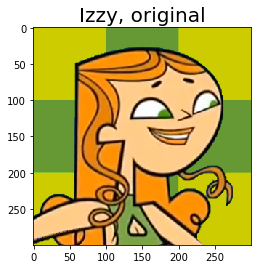

In [12]:
izzy_id = contestant_names.index('Izzy')
izzy_PCA = [] * 37
izzy_im = images[izzy_id]
plt.imshow(izzy_im)
plt.title("Izzy, original", fontsize = 20)
plt.show()

There she is!! Let's make a gif and see a few of reproductions.

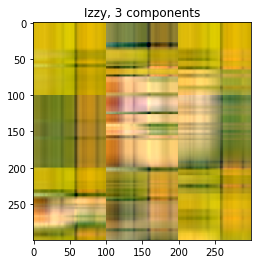

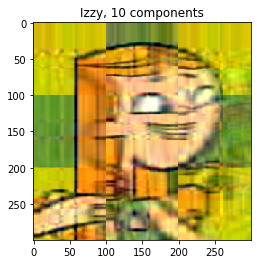

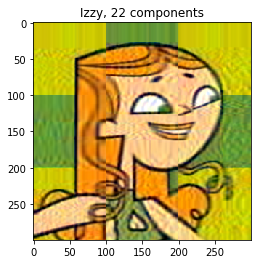

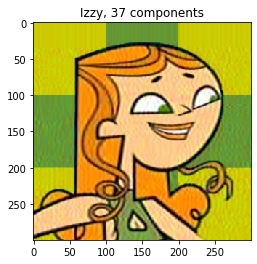

In [13]:
izzy_reshaped = np.reshape(np.array(izzy_im), (300 * 3, 300))
izzy_pcas = [0] * 37
izzy_pcas_transformed = [0] * 37
izzy_approximations = [0] * 37
izzy_plts = [0] * 37

for i in range(37):
    pca = PCA(i + 1)
    izzy_pcas[i] = pca
    izzy_pcas_transformed[i] = pca.fit_transform(izzy_reshaped)
    izzy_approximations[i] = izzy_pcas[i].inverse_transform(izzy_pcas_transformed[i])
    izzy_approximations[i] = izzy_approximations[i].reshape((300, 300, 3))
    izzy_approximations[i] /= 256
    for x in range(300):
            for y in range(300):
                for col in range(3):
                    if izzy_approximations[i][x][y][col] < 0:
                        izzy_approximations[i][x][y][col] = 0
                    elif izzy_approximations[i][x][y][col] > 1:
                        izzy_approximations[i][x][y][col] = 1
    if i == 2 or i == 9 or i == 21 or i == 36:
        plt.imshow(izzy_approximations[i])
        plt.title('Izzy, ' + str(i + 1) + ' components')
        plt.show()

Ok, now let's create a gif from it.

In [14]:
import imageio
imageio.mimsave('./izzy_compresions.gif', izzy_approximations, duration = 5 / 37)

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0

Urgh, I know, these warnings look disgusting! Hopefully in *izzy_compresions.gif* wew can see a beautiful 5 seconds gif of *Izzy* in 37 compression versions.

# BONUS: Reproducing lost signals

At the beginning - traditionalal data load.

In [15]:
import scipy as sp
signals_mixed = sp.genfromtxt("signals.tsv", delimiter="\t", skip_header = 1)

C:\Users\ckostern\anaconda3\lib\site-packages\ipykernel_launcher.py:2: DeprecationWarning: scipy.genfromtxt is deprecated and will be removed in SciPy 2.0.0, use numpy.genfromtxt instead
  


In [16]:
signals_mixed.shape

(10000, 5)

In [17]:
pd_signals_mixed = pd.DataFrame(signals_mixed, columns = ["Id", 1, 2, 3, 4])
pd_signals_mixed.head(10)

,Id,1,2,3,4
0,0.0,0.493428,0.078710,-1.314636,1.193460
1,1.0,0.524618,0.791259,-1.321386,-0.075256
2,2.0,-0.024396,1.064251,-1.582284,0.785229
3,3.0,0.219586,1.007421,-1.481651,0.193773
4,4.0,0.426865,0.943133,-1.521795,-0.433458
5,5.0,-0.702915,1.112053,-1.338925,-0.368491
6,6.0,0.648307,0.697417,-1.603953,-0.067564
7,7.0,0.444403,1.272507,-1.565641,0.238884
8,8.0,-0.230422,0.593870,-1.727421,0.126104
9,9.0,0.364269,1.219993,-1.737690,-0.112812


Great! Now let's visualize it.

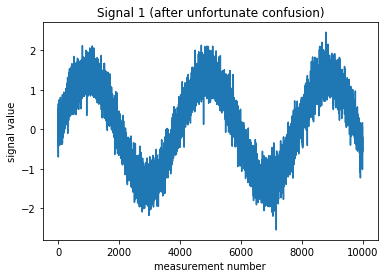

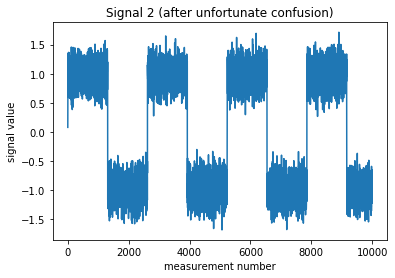

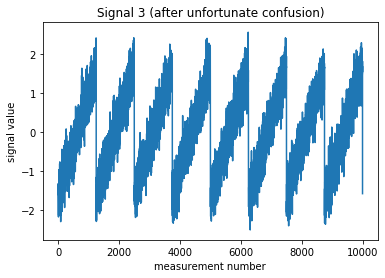

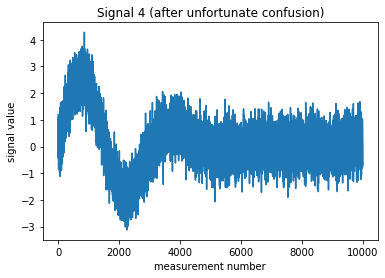

In [18]:
for i in range(4):
    plt.plot(pd_signals_mixed['Id'], pd_signals_mixed[i+1])
    plt.title('Signal ' + str(i + 1) + ' (after unfortunate confusion)')
    plt.xlabel('measurement number')
    plt.ylabel('signal value')
    plt.show()

For me, it looks already great - but let the Independent Component Analysis happen.

In [19]:
from sklearn.decomposition import FastICA

ica = FastICA(4)
signals_reproduced = ica.fit_transform(signals_mixed)
pd_signals_reproduced = pd.DataFrame(signals_reproduced)
pd_signals_reproduced['Id'] = pd_signals_mixed['Id']
pd_signals_reproduced = pd_signals_reproduced[['Id', 0, 1, 2, 3]]
pd_signals_reproduced.columns = ['Id', 1, 2, 3, 4]
pd_signals_reproduced.head(10)

,Id,1,2,3,4
0,0.0,-0.013073,-0.005032,-0.007567,0.013718
1,1.0,-0.014553,-0.001127,-0.011408,0.010212
2,2.0,-0.017267,-0.004004,-0.014535,0.005306
3,3.0,-0.016336,-0.001821,-0.013552,0.007217
4,4.0,-0.016731,0.001009,-0.012538,0.009030
5,5.0,-0.014622,0.004594,-0.019710,0.002601
6,6.0,-0.017175,-0.000810,-0.009851,0.011374
7,7.0,-0.017793,-0.003960,-0.013285,0.006548
8,8.0,-0.017646,0.002638,-0.013877,0.007768
9,9.0,-0.019312,-0.001168,-0.013478,0.006746


Numbers like numbers - it's time to check the final result!

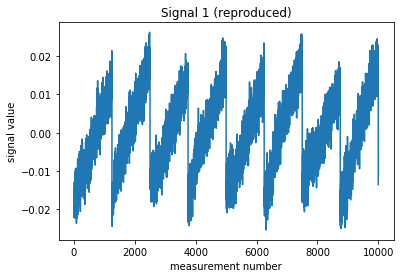

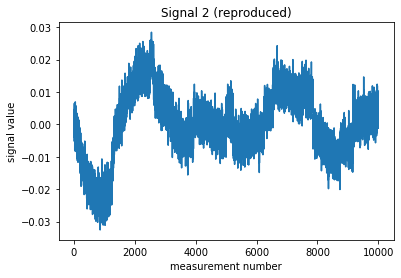

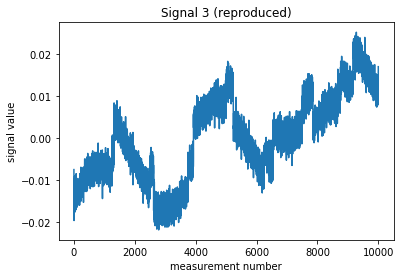

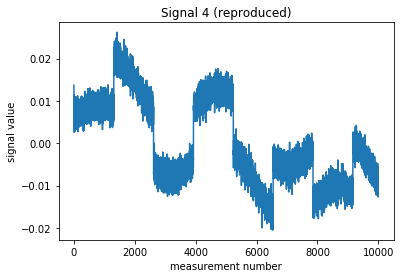

In [20]:
for i in range(4):
    plt.plot(pd_signals_reproduced['Id'], pd_signals_reproduced[i+1])
    plt.title('Signal ' + str(i + 1) + ' (reproduced)')
    plt.xlabel('measurement number')
    plt.ylabel('signal value')
    plt.show()

Interesting! What can I say more...

Very enjoyable last home work, 10/10

In [21]:
%%javascript
$.getScript('https://kmahelona.github.io/ipython_notebook_goodies/ipython_notebook_toc.js')

<IPython.core.display.Javascript object>